**Introducción a las redes neuronales y su aplicación en Geociencia**  by Karen Cruz in licensed under <a href="https://creativecommons.org/licenses/by-nc-nd/4.0?ref=chooser-v1">Attribution-NonCommercial-NoDerivatives 4.0 International</a>

<font size=4>
    
### Generación de las muestras

<font size=5 >

1.  Se genera un conjunto de numeros aleatorios ($(x_1,y_1),(x_2,y_2),…,(x_n,y_n)$)

In [ ]:
#se importan las librerias a usar:
import numpy as np
import random
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
#Se modelan un conjunto de datos (muestras) de la forma (x_i, y_i)

def generador_datos_simple(beta, m, desviacion):
  '''INPUT
    beta: pendiente
    m: número de muestras
    desviacion: desviación agregada entre los x_i y y_i
     OUTPUT
    x: arreglo de (m,1) que contiene a las variables independientes
    y: arreglo de (m,1) que contiene a las variables dependientes
  '''
    
  np.random.seed(3)                      # se fija para que los valores sean reproducibles
  x = np.random.random(m) * 10           # x es arreglo con m numeros aleatorios entre 0 y 100
  e = np.random.randn(m) * desviacion    # e es un error generado aleatoriamente
  y = x * beta + e                       # se obtienen los valores de y 
                                           # x*beta genera una recta, sumando los errores, e, se alejan los puntos de la recta.     
  return x.reshape((m,1)), y.reshape((m,1))

[seed()](https://www.w3schools.com/python/ref_random_seed.asp)

[numpy.random.random()](https://docs.scipy.org/doc/numpy-1.15.0/reference/generated/numpy.random.random.html)

[np.random.randn()](https://docs.scipy.org/doc/numpy-1.15.1/reference/generated/numpy.random.randn.html)

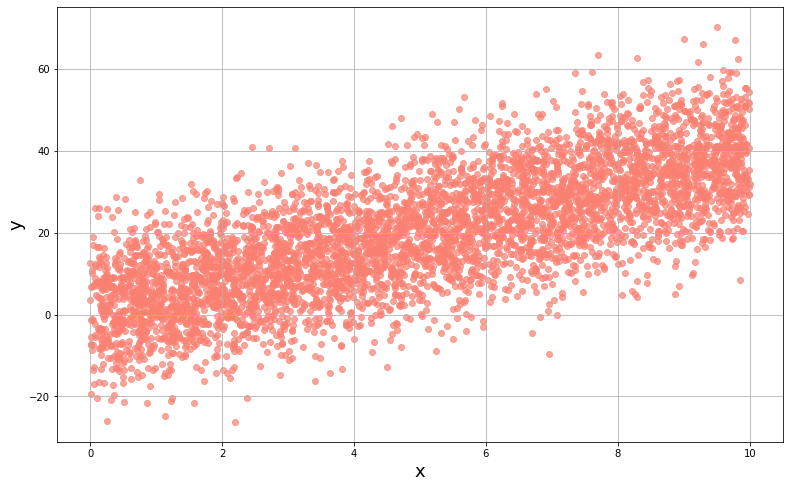

In [ ]:
# se fijan los parametros de la función:
desviacion = 10
beta = 4
m = 5000  

# se llama a la función y el resultado se guarda en x, y:
x, y = generador_datos_simple(beta, m, desviacion)

# graficamos:
plt.figure(figsize=(13,8))
plt.scatter(x, y, color='salmon', alpha=0.7)
plt.grid(True)
plt.xlabel('x', size=18)
plt.ylabel('y', size=18);

<font size=2 color='blue'>

# Buscando la correlación entre las muestras:



<font size=4>

**Se tiene un conjunto de m muestras (puntos) $(x_i, y_i)$, y se busca encontrar una función $f$ que describa una posible correlación entre ellas.**

Analicemos un problema en donde los valores de $y_i$ dependen de los valores de $x_i$. 

Para encontrar esta función, inicialmente se propone un conjunto de funciones definidas todas ellas por misma relación funcional de un conjunto de parámetros (variables). Cada función es definida por valores específicos de estos parámetros.

Por ejemplo, la relación funcional $$f(x) = b + w x$$ define de manera general a todas las funciones que describen una recta en el plano $x-y$. En especial la función 

$$f = 0.0 + 2.0 x$$


define a una recta que corta al eje $y$ en 0.0 y tiene una pendiente de 2.0. 

Mientras que la función $$f = 10.0 + 8.0x,$$ 

 define una recta que corta al eje $y$ en 10.0 y tiene una pendiente de 8.0.

En el presente problema, para encontrar la correlación entre las muestras, proponemos un conjunto de funciones definidas mediante la siguiente relación lineal:

$$ f(x, w, b) = b + w x $$
  
Vemos que esta relación funcional es derivable respecto a todas sus variables, $x, w, b$.


- $w$ se emplea como abreviación de la palabra en inglés "weight", porque se relaciona con la importancia que tiene la variable $x$ en el valor de la función $f$. 

- $b$ es la abreviación de la palabra "bias" en inglés, y se refiere a la referencia respecto a cero de la función $f$. 

*En otra palabras, en una regresión lineal, w es la pendiente y b es la ordenada al origen.*



<font size = 4>

Para encontrar la función que describe la correlación entre los puntos, es necesario generar una métrica para describir qué tanto se acerca cada una de las funciones específicas (con valores definidos de w y de b) a esta descripción.

La métrica que se propone es la siguiente: $$ $$

Para cada muestra $(x_i, y_i)$ se evalua $f(x_i)$ y se compara con el correspondiente valor $y_i$, la diferencia entre estos valores se eleva al cuadrado. $$ (f(x_i)-y_i)^{2}$$


Finalmente se calcula el promedio de este valor sobre todas las muestras, el cual definimos como residuo. En Machine Learning en lugar del término residuo se usa el término **costo**.

Si m es el número de muestras, el residuo queda como:

$$ Residuo = \dfrac {1}{m}∑_{i=1}^{m}(f(x_i)-y_i)^{2} $$

siendo m el número de muestras.


___

<font size=4>

A continuación revisaremos algunas formas de abordar el problema.


<font size=4, color='blue'>
    
> # a) A prueba y error observando la gráfica de la función $f$
    
#### En el siguiente código se implementa la generación del residuo dada una función específica definido por los pesos iniciales w = weight_0, y b = bias_0.

<font size =4>
    

 1. Los parámetros w y b se eligen al azar: 

``` python 

weight_0 = random.randrange(0, 10)

bias_0 = random.randrange(0, 100)

```

[random.randrange()](https://www.w3schools.com/python/ref_random_randrange.asp) ---> returns a randomly selected element from the specified range.

In [ ]:
# se usa la semilla para tener valores reproducibles:
np.random.seed(10)   

#Se inicializan las variables de la función f:
weight_0 = np.random.random()*10
bias_0 = np.random.random()*10

# se imprimen los valores redondeados a 4 cifras
print('w_0:', np.round(weight_0, 4), 'bias_0:', np.round(bias_0, 4)) 

w_0: 7.7132 bias_0: 0.2075


<font size=4>

 2. Se grafica la correspondiente función f, junto con los puntos que representan a las muestras

residuo: 578.279557134238


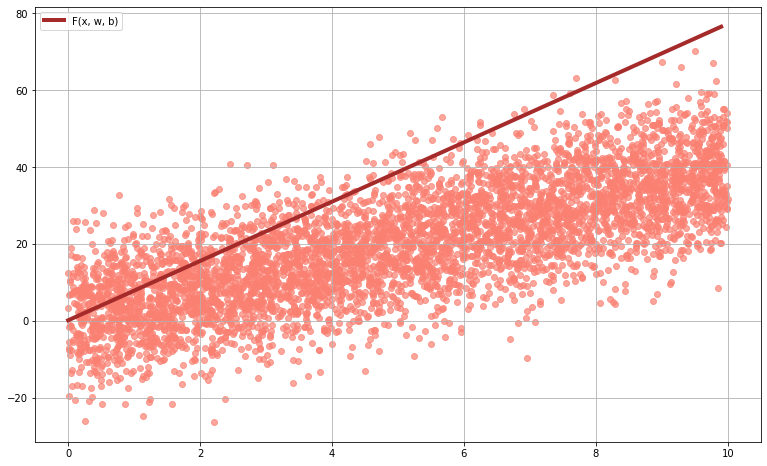

In [ ]:
#1. Los siguientes arreglos se definen para graficar la función f(x, weight_0, bias_0)

x_ = np.arange(0.0, 10.0, 0.1) # genera un conjunto de valores iniciando en 0.0, terminando en 10.0 y a pasos de 0.1
y_ = weight_0*x_ + bias_0      # y es la función F(x_, w, b) generada con w_0 y b_0 

#2. Usando la función f, se calcula el residuo para comparar con los valores 'medidos' (generados)

residuo = 0
for i in range(len(x)):   # para cada muestra:
    r = (y[i] - weight_0*x[i] - bias_0)**2
    residuo += np.squeeze(r)
residuo = residuo/len(x)

print('residuo:', residuo)


#3. Se grafica la función f junto con las muestras

plt.figure(figsize=(13,8))
plt.grid(True)
    # funcion
plt.plot(x_, y_, color='brown', lw=4, label='F(x, w, b)') # x_, y_ son los valores que definen a f(X, w_0, b_0)
plt.legend()
    #muestras
plt.scatter(x, y, color='salmon', alpha=0.7);                                        # x, y son las muestras generadas

<font size=4>

Como se observa en la gráfica, esta función está lejos de describir la correlación entre los puntos. 


<font color='blue'>
    

 Los valores del peso *w* y el bias *b* se actualizan iterativamente a prueba y error. Para ello se deben hacer los cambios de acuedo a la gráfica (residuo) que se obtenga.

In [ ]:
def update_weights_biases(weight, bias, value_to_update_weight, value_to_update_bias):
    
    '''Esta función actualiza los valores de w y b y calcula el respectivo residuo
    
    INPUT:
        weight: peso actual
        bias: bias actual
        value_to_update_weight: valor a agregar para actualizar el peso
        value_to_update_bias: valor a agregar para actualizar el bias
    OUTPUT:
        weigth: el peso actualizado
        bias: el bias actualizado
        residuo: el residuo que se genera con la nueva función f con el peso y bias actualizados'''
    
    # Actualización de peso y bias:
    weight = weight + value_to_update_weight
    bias = bias + value_to_update_bias

    print('w:', weight)
    print('b:', bias)

    #The following date are for constructing the F(x,weight, bias)
    x_ = np.arange(0.0, 10.0, 0.1)
    y_ = weight*x_ + bias           # se calcula la nueva función f

    # se grafica la nueva función f y las muestras:
    plt.figure(figsize=(13,8))
    plt.grid(True)
    plt.ylabel('Y', fontsize=16)
    plt.xlabel('X', fontsize=16)
    
    # grafica de f
    plt.plot(x_, y_, 'orchid', lw=4, label='F(x,w,b)')
    plt.legend()

    # grafica de las muestras
    plt.scatter(x, y, color='salmon', alpha=0.7);
    
    # calculo del residuo:
    residuo = 0
    for i in range(len(x)):
        r = (y[i]- weight*x[i] - bias)**2
        residuo += np.squeeze(r)   
    residuo = residuo/len(x)
    print('residuo: {:10.2f}'.format(residuo))
         
    return weight, bias, residuo

w: 8.713206432667459
b: -9.792480506405985
residuo:     484.81


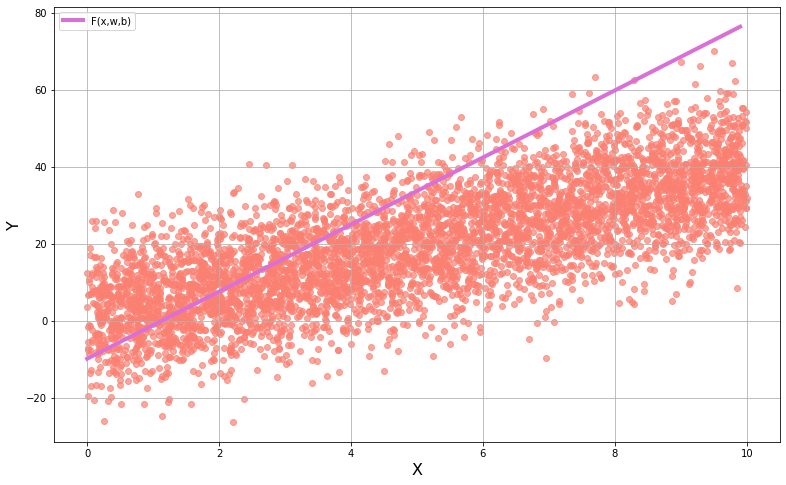

In [ ]:
weight_1, bias_1, residuo_1 = update_weights_biases(weight_0, bias_0, 1, -10.0)

<font size=4>

Se comparan las dos graficas anteriores, es decir, $f(x)=w_0 x + b_0$ con $f(x)=w_1 x + b_1$

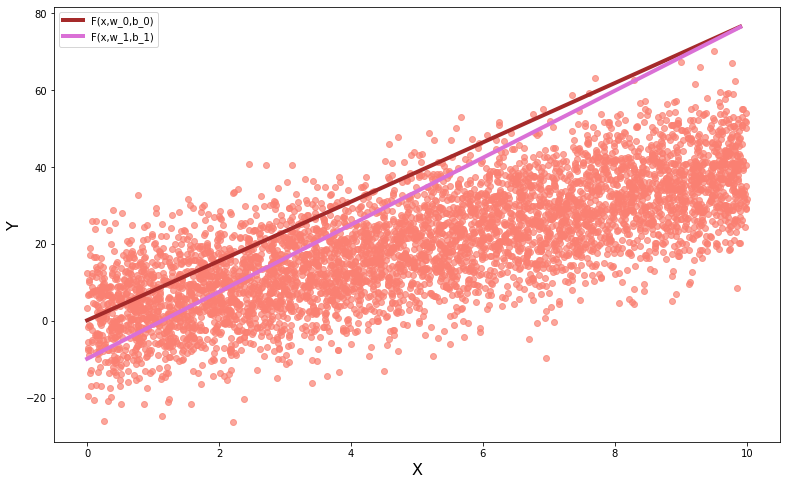

In [ ]:
x_ = np.arange(0.0, 10.0, 0.1)
y_0 = weight_0*x_ + bias_0     # función inicial
y_1 = weight_1*x_ + bias_1     # función actualizada


plt.figure(figsize=(13,8))
plt.ylabel('Y', fontsize=16)
plt.xlabel('X', fontsize=16)

#Grafica de las funciones:
plt.plot(x_, y_0, 'brown', lw=4, label='F(x,w_0,b_0)')
plt.plot(x_, y_1, 'orchid', lw=4, label='F(x,w_1,b_1)')
plt.legend()
# grafica de las muestras:
plt.scatter(x, y, color='salmon', alpha=0.7);

<font size=4>

El cambio es muy pequeño, por lo que se actualizara al peso con -3.0 y el bias a 10.0. 

w: 5.713206432667459
b: 0.207519493594015
residuo:     206.47


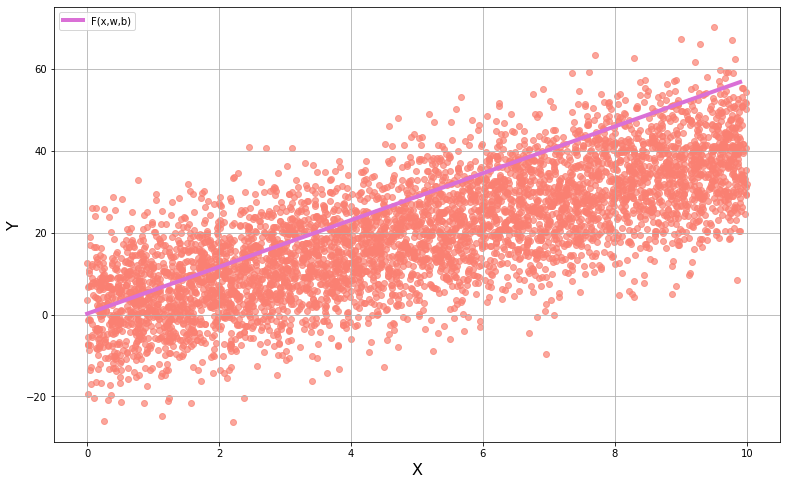

In [ ]:
weight_2, bias_2, residuo_2 = update_weights_biases(weight_1, bias_1, -3, 10)

<font size=4>

Se compara con la versión anterior

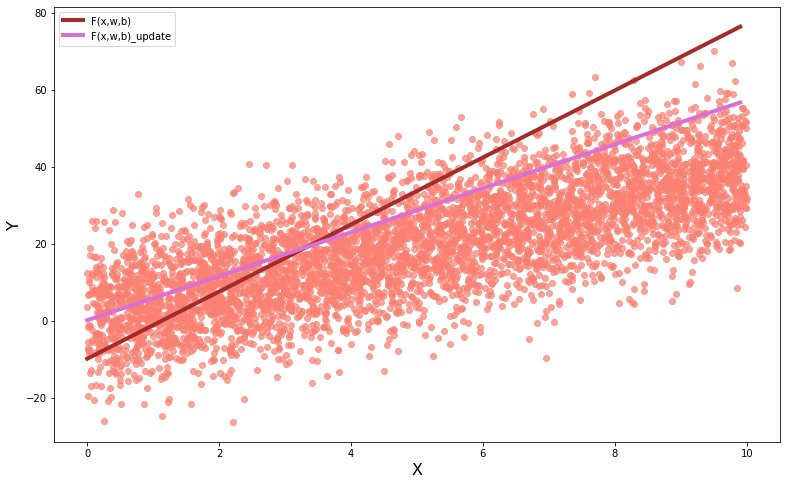

In [ ]:
x_ = np.arange(0.0, 10.0, 0.1)
y_1 = weight_1*x_ + bias_1
y_2 = weight_2*x_ + bias_2


plt.figure(figsize=(13,8))
plt.ylabel('Y', fontsize=16)
plt.xlabel('X', fontsize=16)

plt.plot(x_, y_1, 'brown', lw=4, label='F(x,w,b)')
plt.plot(x_, y_2, 'orchid', lw=4, label='F(x,w,b)_update')
plt.legend()

plt.scatter(x, y, color='salmon', alpha=0.7);

<font size=4>

Aún se puede mejorar:

w: 3.7132064326674588
b: -0.792480506405985
residuo:     104.21


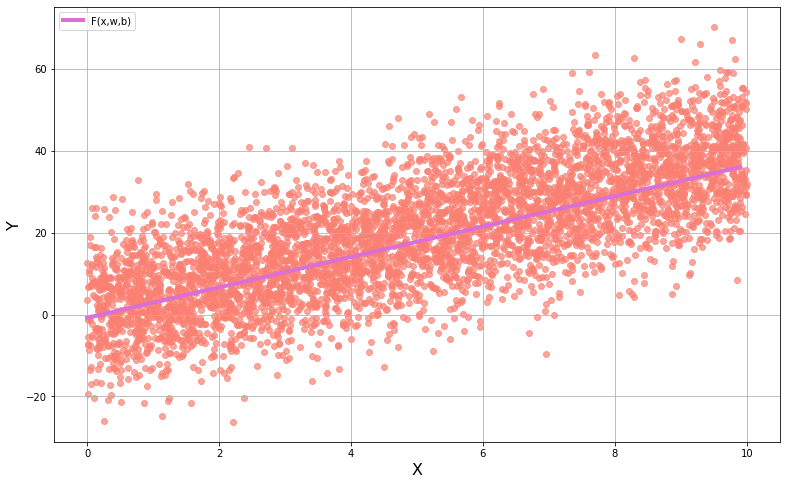

In [ ]:
weight_3, bias_3, residuo_3 = update_weights_biases(weight_2, bias_2, -2, -1)

<font size=4>

Se comparan las dos graficas anteriores

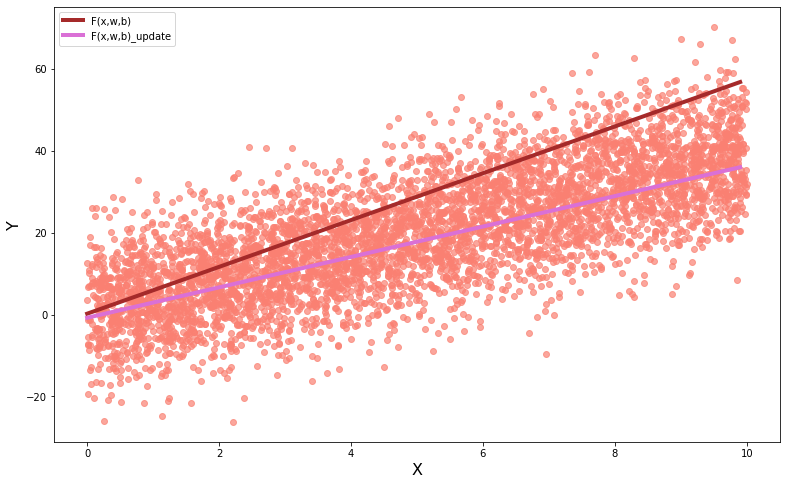

In [ ]:
x_ = np.arange(0.0, 10.0, 0.1)
y_2 = weight_2*x_ + bias_2
y_3 = weight_3*x_ + bias_3


plt.figure(figsize=(13,8))
plt.ylabel('Y', fontsize=16)
plt.xlabel('X', fontsize=16)

plt.plot(x_, y_2, 'brown', lw=4, label='F(x,w,b)')
plt.plot(x_, y_3, 'orchid', lw=4, label='F(x,w,b)_update')
plt.legend()

plt.scatter(x, y, color='salmon', alpha=0.7);

<font size=4>

Se prueba aumentando la ordenada un poco mas:

w: 3.7132064326674588
b: 4.207519493594015
residuo:     108.71


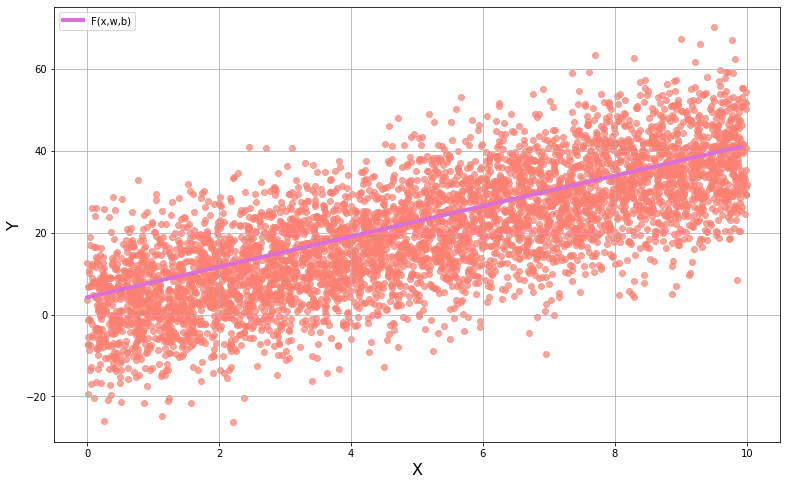

In [ ]:
weight_4, bias_4, residuo_4 = update_weights_biases(weight_3, bias_3, 0, 5.0)

<font size=4>

Comparación con la función anterior:

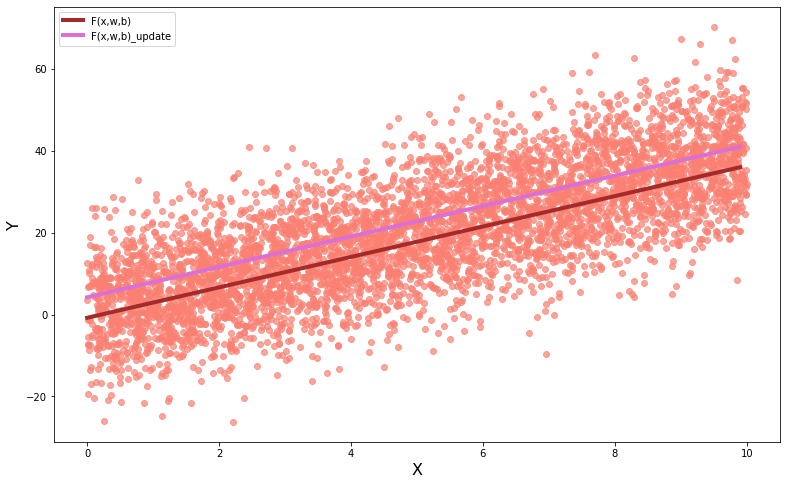

In [ ]:
x_ = np.arange(0.0, 10.0, 0.1)
y_3 = weight_3*x_ + bias_3
y_4 = weight_4*x_ + bias_4


plt.figure(figsize=(13,8))
plt.ylabel('Y', fontsize=16)
plt.xlabel('X', fontsize=16)

plt.plot(x_, y_3, 'brown', lw=4, label='F(x,w,b)')
plt.plot(x_, y_4, 'orchid', lw=4, label='F(x,w,b)_update')
plt.legend()

plt.scatter(x, y, color='salmon', alpha=0.7);

<font size=4 color='red'>

**Se puede mejorar, la idea es observar el cambio en el residuo con los cambios en w y en b.**

___

<font size=4 color='blue'>

> # b) Buscando el residuo mínimo

 Busquemos encontrar la función que defina la correlación generando un conjunto de funciones y calcular los correspondientes residuos.

In [ ]:
residuo= 0

for i in range(len(x)):
    r = (y[i]-weight_0*x[i]- bias_0)**2
    residuo += np.squeeze(r)
residuo = residuo/len(x)

print('residuo: {0:10.2f}'.format(residuo))

residuo:     578.28


<font size=4>

La función **update_weight_bias()** actualiza a los parametros weight y bias, y calcula el residuo.

 Primero vamos a dejar fija a b y vamos a variar a w.

w: 7.5132064326674595
b: 0.0
residuo:     521.70
weight:       7.51 bias:       0.00 residuo:     521.70
w: 7.313206432667459
b: 0.0
residuo:     475.61
weight:       7.31 bias:       0.00 residuo:     475.61
w: 7.113206432667459
b: 0.0
residuo:     432.18
weight:       7.11 bias:       0.00 residuo:     432.18
w: 6.913206432667459
b: 0.0
residuo:     391.42
weight:       6.91 bias:       0.00 residuo:     391.42
w: 6.713206432667459
b: 0.0
residuo:     353.32
weight:       6.71 bias:       0.00 residuo:     353.32
w: 6.513206432667459
b: 0.0
residuo:     317.89
weight:       6.51 bias:       0.00 residuo:     317.89
w: 6.313206432667458
b: 0.0
residuo:     285.12
weight:       6.31 bias:       0.00 residuo:     285.12
w: 6.113206432667458
b: 0.0
residuo:     255.01
weight:       6.11 bias:       0.00 residuo:     255.01
w: 5.913206432667458
b: 0.0
residuo:     227.57
weight:       5.91 bias:       0.00 residuo:     227.57
w: 5.713206432667458
b: 0.0
residuo:     202.80
weight:       5

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


residuo:     113.32
weight:       3.31 bias:       0.00 residuo:     113.32
w: 3.1132064326674556
b: 0.0
residuo:     123.19
weight:       3.11 bias:       0.00 residuo:     123.19
w: 2.9132064326674554
b: 0.0
residuo:     135.71
weight:       2.91 bias:       0.00 residuo:     135.71
w: 2.713206432667455
b: 0.0
residuo:     150.90
weight:       2.71 bias:       0.00 residuo:     150.90
w: 2.513206432667455
b: 0.0
residuo:     168.76
weight:       2.51 bias:       0.00 residuo:     168.76
w: 2.313206432667455
b: 0.0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

residuo:     189.28
weight:       2.31 bias:       0.00 residuo:     189.28
w: 2.1132064326674547
b: 0.0
residuo:     212.47
weight:       2.11 bias:       0.00 residuo:     212.47
w: 1.9132064326674547
b: 0.0
residuo:     238.32
weight:       1.91 bias:       0.00 residuo:     238.32
w: 1.7132064326674548
b: 0.0
residuo:     266.83
weight:       1.71 bias:       0.00 residuo:     266.83
w: 1.5132064326674548
b: 0.0
residuo:     298.01
weight:       1.51 bias:       0.00 residuo:     298.01
w: 1.3132064326674548
b: 0.0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

residuo:     331.85
weight:       1.31 bias:       0.00 residuo:     331.85
w: 1.113206432667455
b: 0.0
residuo:     368.36
weight:       1.11 bias:       0.00 residuo:     368.36
w: 0.9132064326674549
b: 0.0
residuo:     407.53
weight:       0.91 bias:       0.00 residuo:     407.53
w: 0.713206432667455
b: 0.0
residuo:     449.37
weight:       0.71 bias:       0.00 residuo:     449.37
w: 0.513206432667455
b: 0.0
residuo:     493.87
weight:       0.51 bias:       0.00 residuo:     493.87
w: 0.313206432667455
b: 0.0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

residuo:     541.04
weight:       0.31 bias:       0.00 residuo:     541.04
w: 0.113206432667455
b: 0.0
residuo:     590.87
weight:       0.11 bias:       0.00 residuo:     590.87
w: -0.08679356733254501
b: 0.0
residuo:     643.36
weight:      -0.09 bias:       0.00 residuo:     643.36
w: -0.286793567332545
b: 0.0
residuo:     698.52
weight:      -0.29 bias:       0.00 residuo:     698.52
w: -0.48679356733254503
b: 0.0
residuo:     756.34
weight:      -0.49 bias:       0.00 residuo:     756.34
w: -0.686793567332545
b: 0.0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

residuo:     816.83
weight:      -0.69 bias:       0.00 residuo:     816.83
w: -0.8867935673325451
b: 0.0
residuo:     879.99
weight:      -0.89 bias:       0.00 residuo:     879.99
w: -1.086793567332545
b: 0.0
residuo:     945.80
weight:      -1.09 bias:       0.00 residuo:     945.80
w: -1.286793567332545
b: 0.0
residuo:    1014.28
weight:      -1.29 bias:       0.00 residuo:    1014.28
w: -1.486793567332545
b: 0.0


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

residuo:    1085.43
weight:      -1.49 bias:       0.00 residuo:    1085.43
w: -1.686793567332545
b: 0.0
residuo:    1159.24
weight:      -1.69 bias:       0.00 residuo:    1159.24
w: -1.8867935673325449
b: 0.0
residuo:    1235.72
weight:      -1.89 bias:       0.00 residuo:    1235.72
w: -2.086793567332545
b: 0.0
residuo:    1314.86
weight:      -2.09 bias:       0.00 residuo:    1314.86
w: -2.2867935673325452
b: 0.0
residuo:    1396.66
weight:      -2.29 bias:       0.00 residuo:    1396.66


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

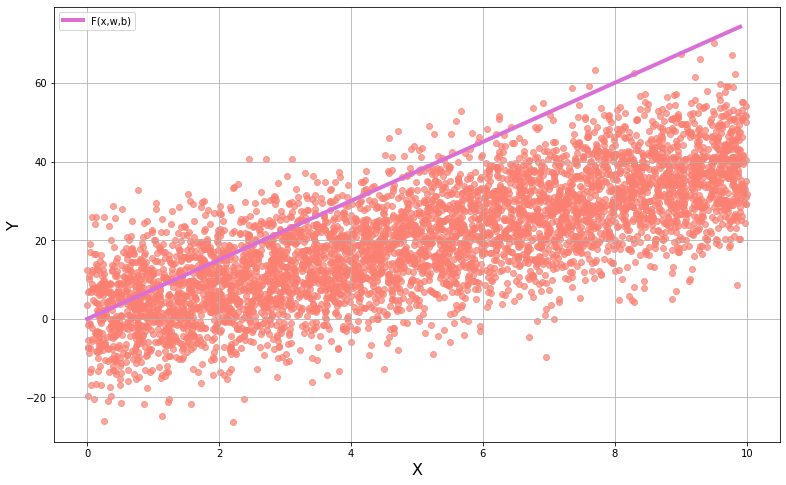

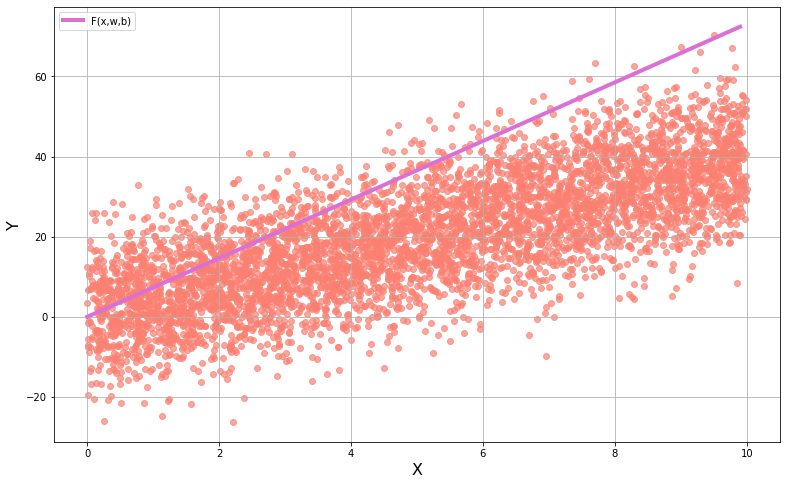

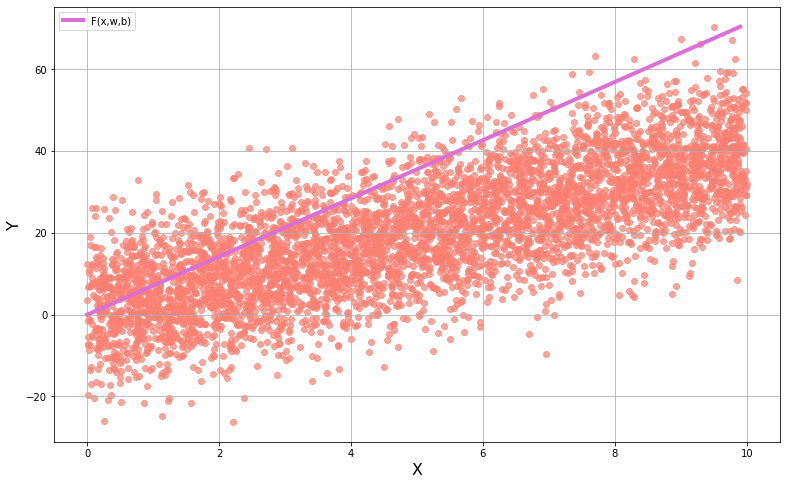

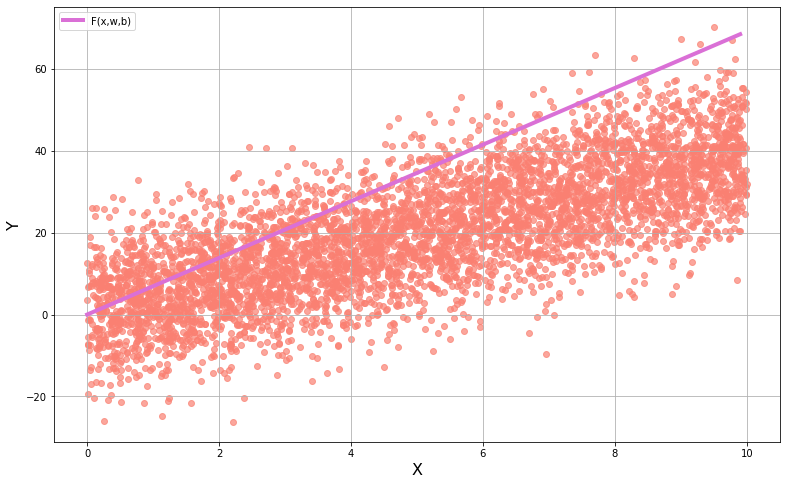

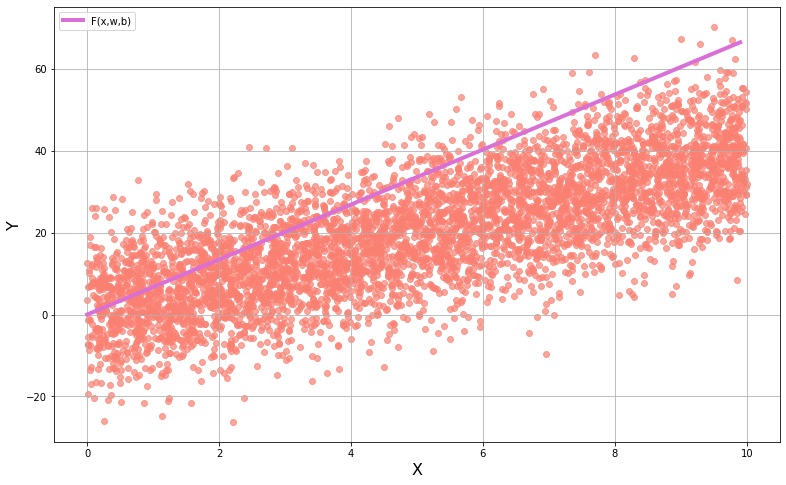

...

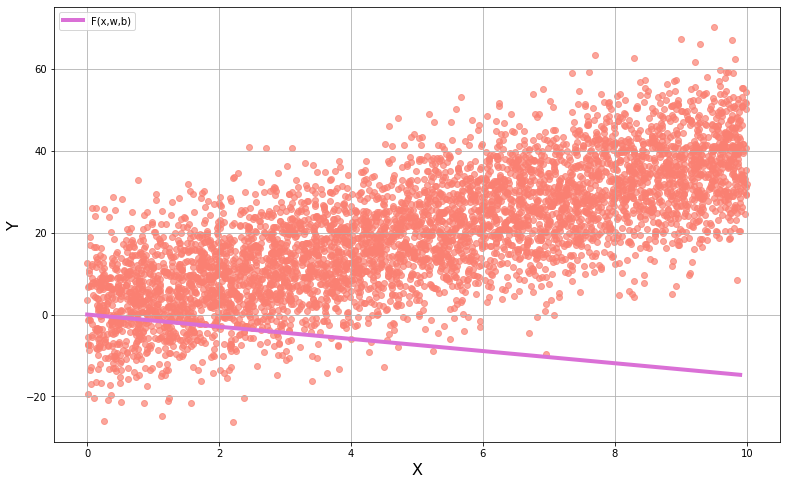

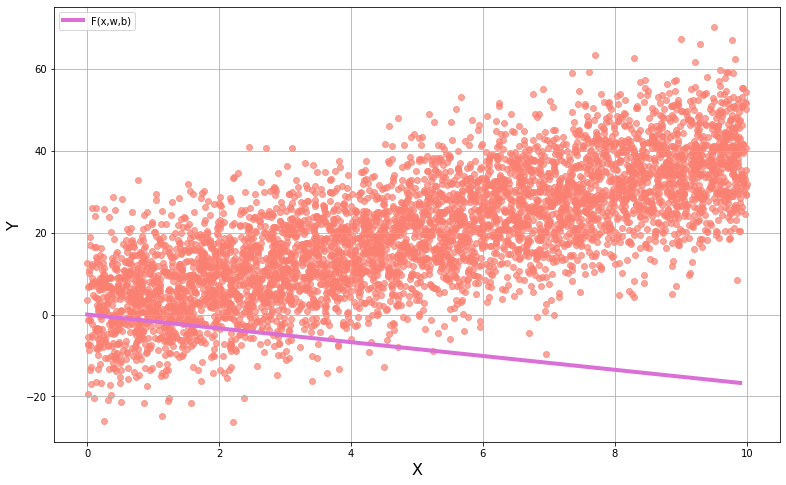

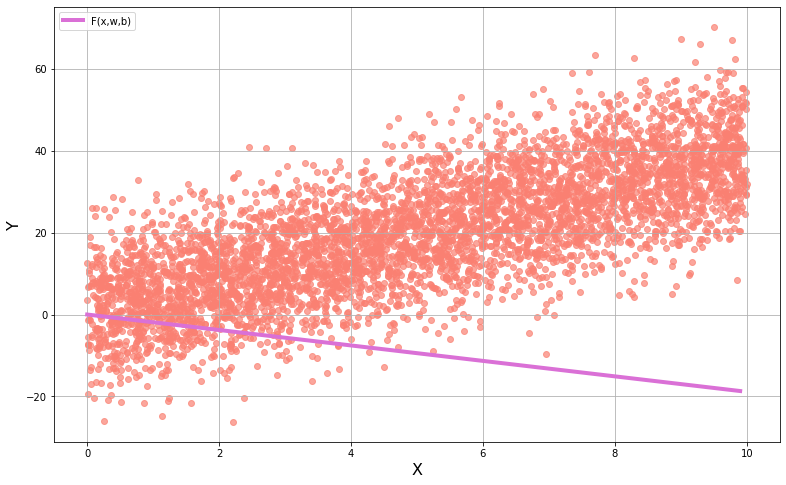

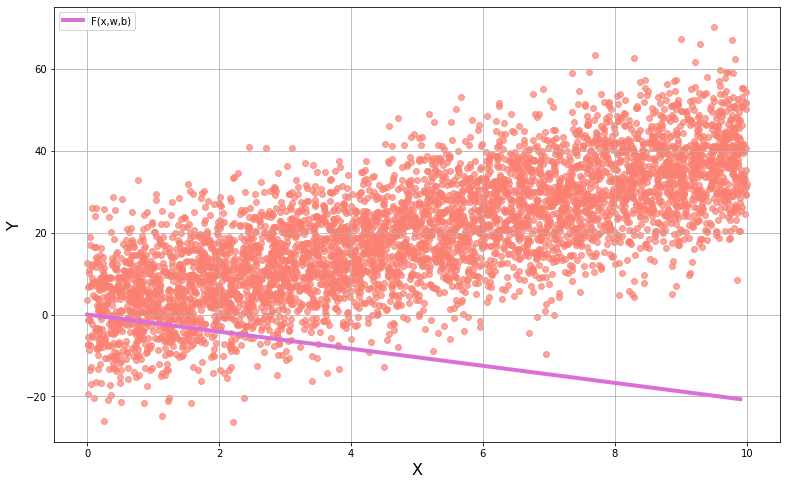

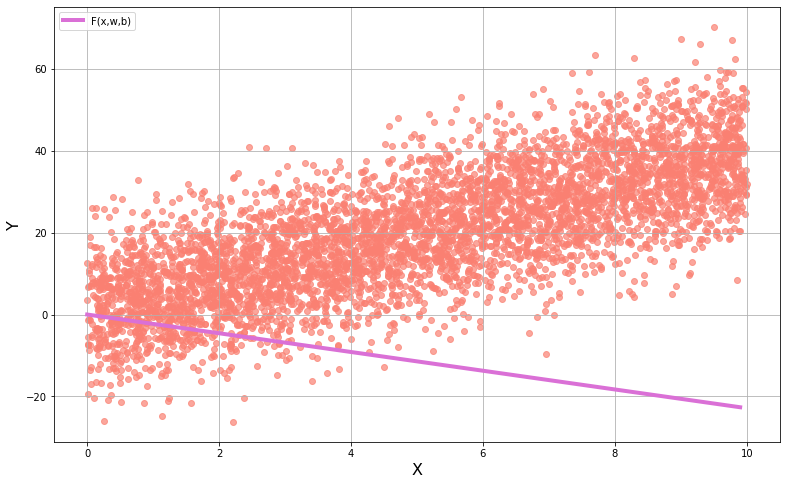

In [ ]:
parameters_b_fijo = []

weight = weight_0
bias_fijo = 0.0

for i in range(50):
    
    weight, bias, residuo_b_fijo = update_weights_biases(weight, bias_fijo, -0.2, 0)
    parameters_b_fijo.append([weight, bias, residuo_b_fijo])
    print('weight: {0:10.2f} bias: {1:10.2f} residuo: {2:10.2f}'.format(weight,bias, residuo_b_fijo))

<font size=4>

Graficamos algunas de las funciones obtenidas:

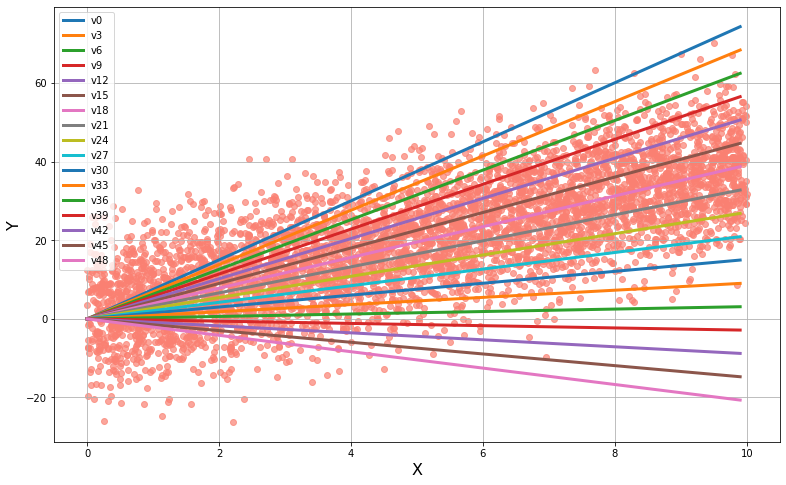

In [ ]:
plt.figure(figsize=(13,8))
plt.ylabel('Y', fontsize=16)
plt.xlabel('X', fontsize=16)
plt.grid(True)

for i in range(0,50,3):
    plt.plot(x_, parameters_b_fijo[i][0]*x_ + parameters_b_fijo[i][1], label='v' + str(i), lw=3)
    plt.legend()

plt.scatter(x, y, color='salmon', alpha=0.7);

<font size=4>

A continuación se grafica el residuo en función de la pendiente, w.
 
 El valor óptimo de la pendiente es aquel que minimiza al residuo. 

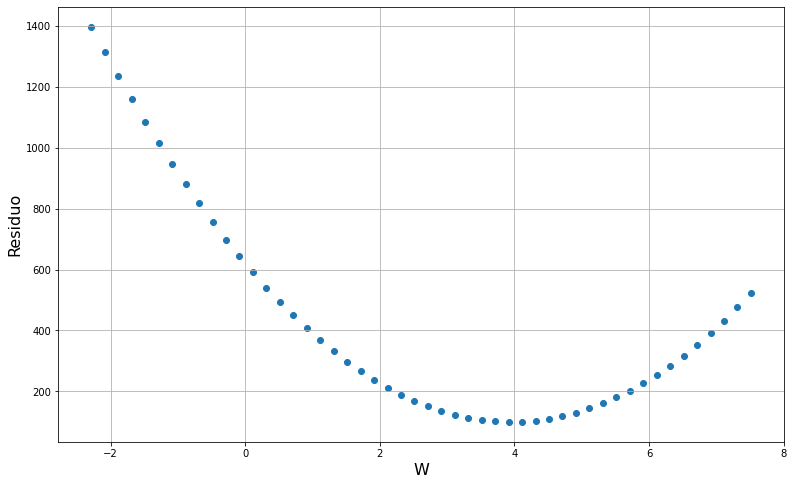

In [ ]:
plt.figure(figsize=(13,8))
plt.ylabel('Residuo', fontsize=16)
plt.xlabel('W', fontsize=16)
plt.grid(True)

weights = []
residuos_handMSE_b_fijo = []

for i in parameters_b_fijo: 
    weights.append(i[0])
    residuos_handMSE_b_fijo.append(i[2])
    
plt.scatter(weights, residuos_handMSE_b_fijo);

<font size = 4>

Como se observa en la grafica anterior, el mínimo de la pendiente esta cerca de 4, en $ w \approx 4$.

In [ ]:
index_min = np.argmin(residuos_handMSE_b_fijo)
print('El residuo mas pequeño tiene el valor: {0:10.2f}'.format(parameters_b_fijo[index_min][2]))

print('Los valores optimos de los parámetros son w = {0:5.2f} y b = {1:5.2f} ' \
      .format(parameters_b_fijo[index_min][0], parameters_b_fijo[index_min][1]))

El residuo mas pequeño tiene el valor:      99.72
Los valores optimos de los parámetros son w =  3.91 y b =  0.00 


<font size = 4>

Se grafica la recta con los valores óptimos de w, $ \hat w $, y la $ b $ propuesta:

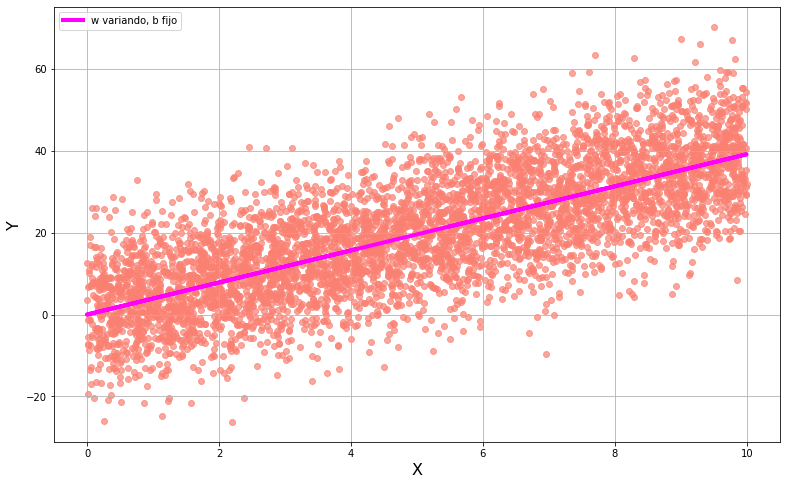

In [ ]:
plt.figure(figsize=(13,8))
plt.ylabel('Y', fontsize=16)
plt.xlabel('X', fontsize=16)
plt.grid(True)

plt.plot(x, parameters_b_fijo[np.argmin(residuos_handMSE_b_fijo)][0]*x+bias_fijo, color='magenta', label='w variando, b fijo', lw=4)
plt.legend()


plt.scatter(x, y, color='salmon', alpha=0.7);

 Ahora se va a realizar un proceso similiar al anterior pero ahora se va a dejar fijo w y se va a variar a b.

w: 5.0
b: -19.2
residuo:     305.85
weight:       5.00 bias:     -19.20 residuo:     305.85
w: 5.0
b: -18.4
residuo:     284.06
weight:       5.00 bias:     -18.40 residuo:     284.06
w: 5.0
b: -17.599999999999998
residuo:     263.54
weight:       5.00 bias:     -17.60 residuo:     263.54
w: 5.0
b: -16.799999999999997
residuo:     244.31
weight:       5.00 bias:     -16.80 residuo:     244.31
w: 5.0
b: -15.999999999999996
residuo:     226.36
weight:       5.00 bias:     -16.00 residuo:     226.36
w: 5.0
b: -15.199999999999996
residuo:     209.69
weight:       5.00 bias:     -15.20 residuo:     209.69
w: 5.0
b: -14.399999999999995
residuo:     194.30
weight:       5.00 bias:     -14.40 residuo:     194.30
w: 5.0
b: -13.599999999999994
residuo:     180.19
weight:       5.00 bias:     -13.60 residuo:     180.19
w: 5.0
b: -12.799999999999994
residuo:     167.36
weight:       5.00 bias:     -12.80 residuo:     167.36
w: 5.0
b: -11.999999999999993
residuo:     155.81
weight:       5.00 bias:

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

residuo:     136.14
weight:       5.00 bias:       0.00 residuo:     136.14
w: 5.0
b: 0.8000000000000087
residuo:     145.07
weight:       5.00 bias:       0.80 residuo:     145.07
w: 5.0
b: 1.6000000000000087
residuo:     155.28
weight:       5.00 bias:       1.60 residuo:     155.28
w: 5.0
b: 2.400000000000009
residuo:     166.77
weight:       5.00 bias:       2.40 residuo:     166.77
w: 5.0
b: 3.200000000000009
residuo:     179.53
weight:       5.00 bias:       3.20 residuo:     179.53
w: 5.0
b: 4.000000000000009


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

residuo:     193.58
weight:       5.00 bias:       4.00 residuo:     193.58
w: 5.0
b: 4.800000000000009
residuo:     208.91
weight:       5.00 bias:       4.80 residuo:     208.91
w: 5.0
b: 5.6000000000000085
residuo:     225.52
weight:       5.00 bias:       5.60 residuo:     225.52
w: 5.0
b: 6.400000000000008
residuo:     243.41
weight:       5.00 bias:       6.40 residuo:     243.41
w: 5.0
b: 7.200000000000008
residuo:     262.58
weight:       5.00 bias:       7.20 residuo:     262.58
w: 5.0
b: 8.000000000000009


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

residuo:     283.03
weight:       5.00 bias:       8.00 residuo:     283.03
w: 5.0
b: 8.80000000000001
residuo:     304.76
weight:       5.00 bias:       8.80 residuo:     304.76
w: 5.0
b: 9.60000000000001
residuo:     327.77
weight:       5.00 bias:       9.60 residuo:     327.77
w: 5.0
b: 10.400000000000011
residuo:     352.05
weight:       5.00 bias:      10.40 residuo:     352.05
w: 5.0
b: 11.200000000000012
residuo:     377.62
weight:       5.00 bias:      11.20 residuo:     377.62
w: 5.0
b: 12.000000000000012


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

residuo:     404.47
weight:       5.00 bias:      12.00 residuo:     404.47
w: 5.0
b: 12.800000000000013
residuo:     432.60
weight:       5.00 bias:      12.80 residuo:     432.60
w: 5.0
b: 13.600000000000014
residuo:     462.01
weight:       5.00 bias:      13.60 residuo:     462.01
w: 5.0
b: 14.400000000000015
residuo:     492.70
weight:       5.00 bias:      14.40 residuo:     492.70
w: 5.0
b: 15.200000000000015
residuo:     524.67
weight:       5.00 bias:      15.20 residuo:     524.67
w: 5.0
b: 16.000000000000014


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

residuo:     557.92
weight:       5.00 bias:      16.00 residuo:     557.92
w: 5.0
b: 16.800000000000015
residuo:     592.45
weight:       5.00 bias:      16.80 residuo:     592.45
w: 5.0
b: 17.600000000000016
residuo:     628.25
weight:       5.00 bias:      17.60 residuo:     628.25
w: 5.0
b: 18.400000000000016
residuo:     665.34
weight:       5.00 bias:      18.40 residuo:     665.34
w: 5.0
b: 19.200000000000017


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

residuo:     703.71
weight:       5.00 bias:      19.20 residuo:     703.71
w: 5.0
b: 20.000000000000018
residuo:     743.36
weight:       5.00 bias:      20.00 residuo:     743.36


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


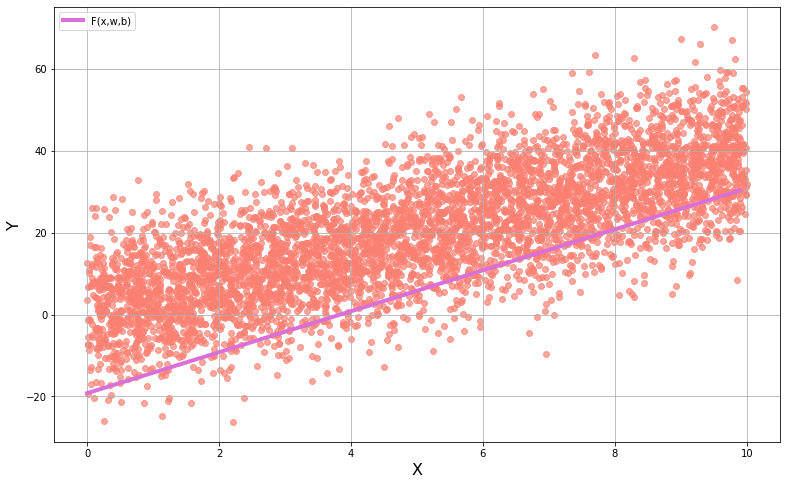

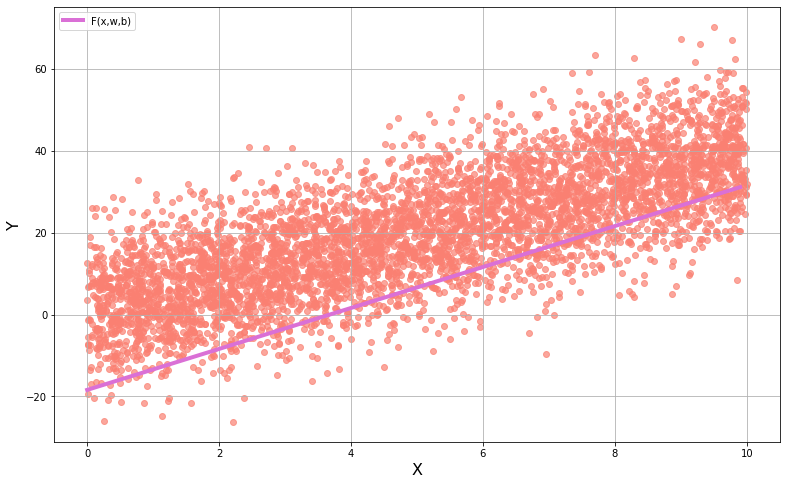

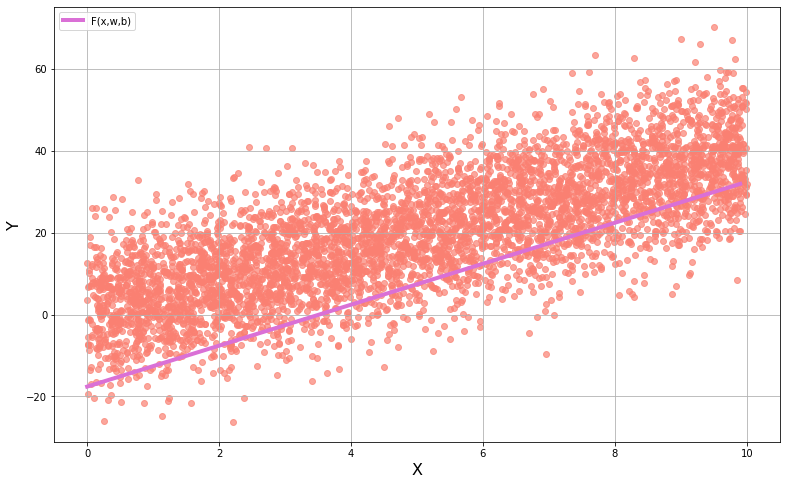

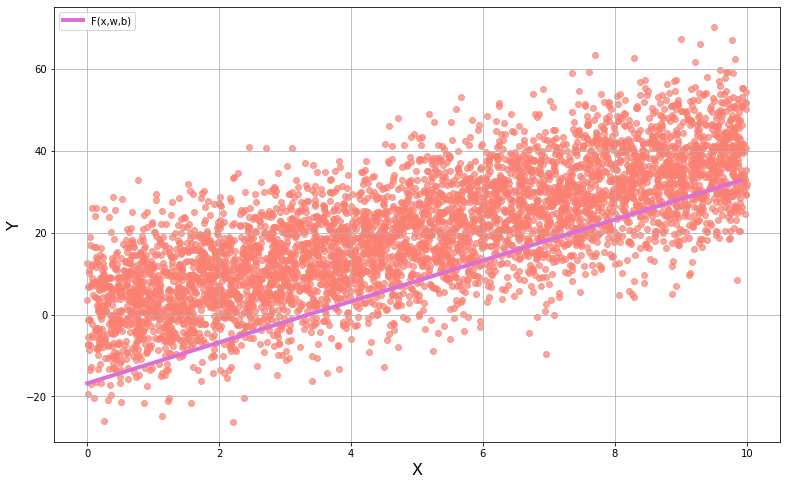

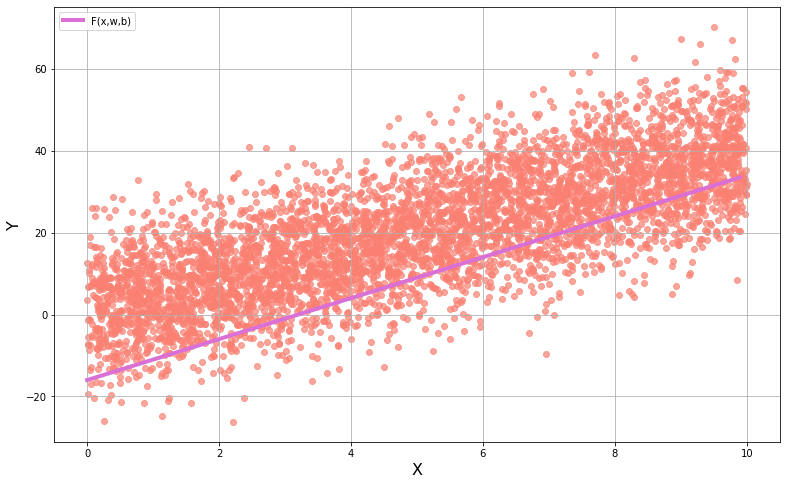

...

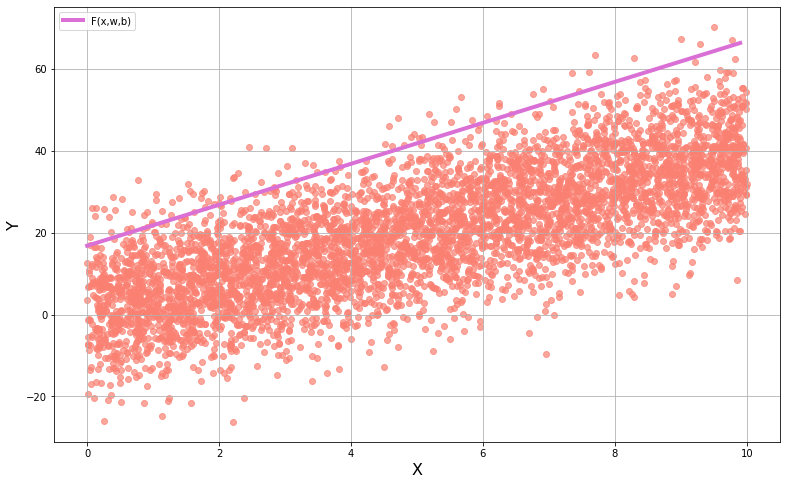

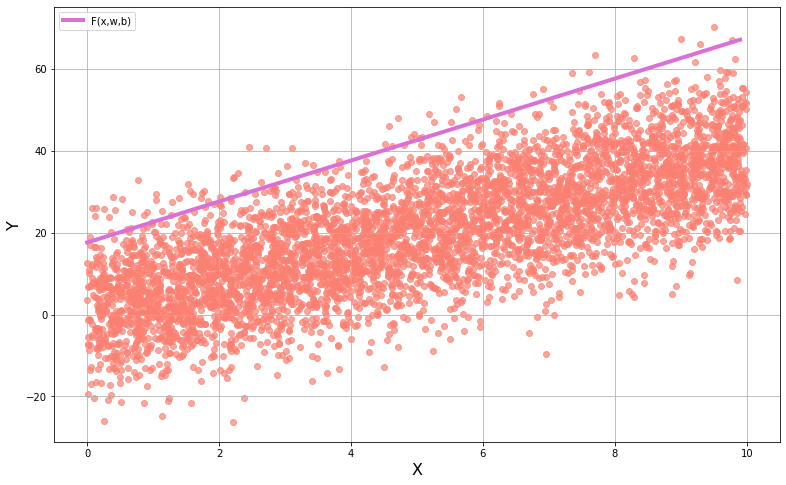

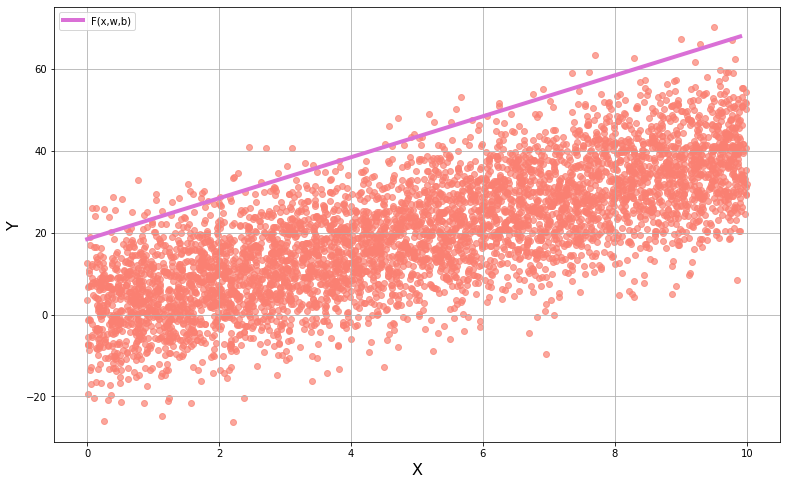

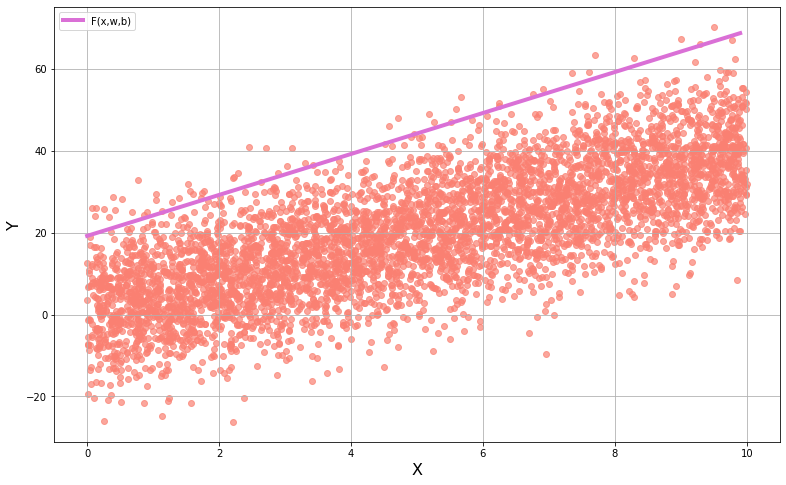

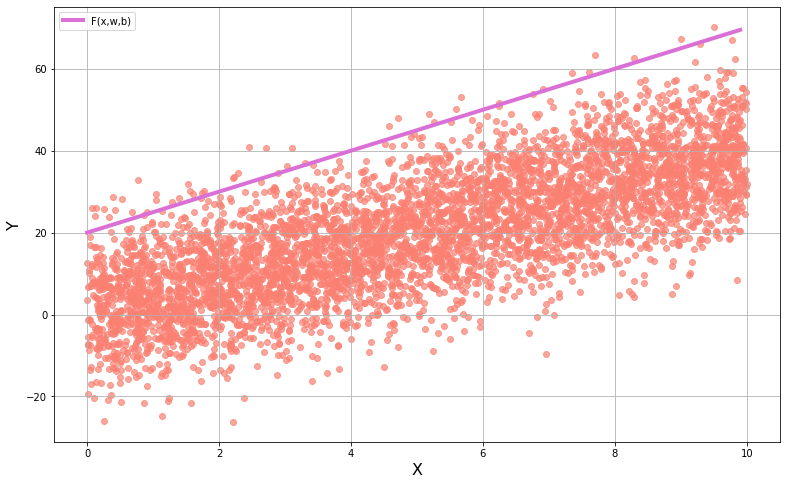

In [ ]:
parameters_w_fijo = []

weight_fijo = 5.0
bias = -20
for i in range(50):
    
    weight, bias, residuo_w_fijo = update_weights_biases(weight_fijo, bias, 0, 0.8)
    
    parameters_w_fijo.append([weight, bias, residuo_w_fijo])

    print('weight: {0:10.2f} bias: {1:10.2f} residuo: {2:10.2f}'.format(weight,bias, residuo_w_fijo))

<font size=4>

Graficamos algunas de las funciones obtenidas:

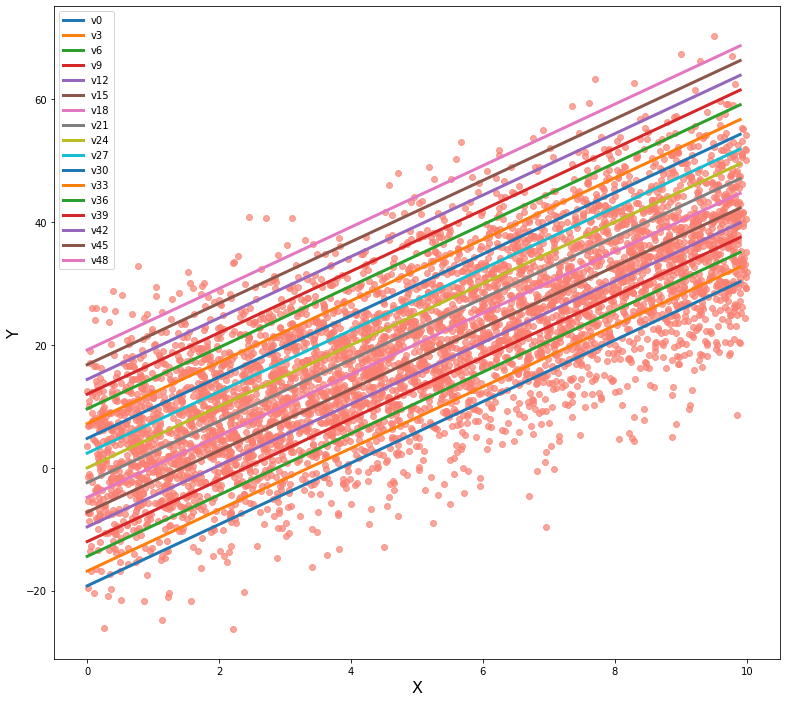

In [ ]:
plt.figure(figsize=(13,12))
plt.ylabel('Y', fontsize=16)
plt.xlabel('X', fontsize=16)

for i in range(0,50,3):
    plt.plot(x_, weight_fijo*x_ + parameters_w_fijo[i][1], label='v' + str(i), lw=3)
    plt.legend()


plt.scatter(x, y, color='salmon', alpha=0.7);

<font size=4>

A continuación se grafica el residuo en función de b (ordenada al origen).
 
El valor óptimo de b es aquel que minimiza al residuo.

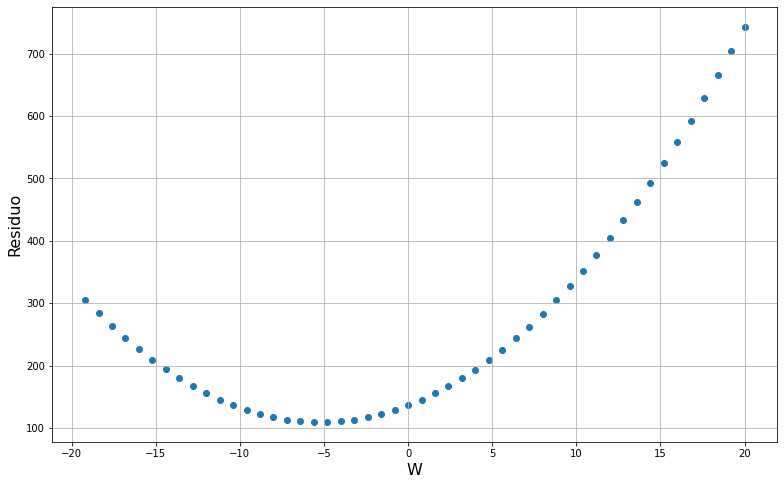

In [ ]:
plt.figure(figsize=(13,8))
plt.ylabel('Residuo', fontsize=16)
plt.xlabel('W', fontsize=16)
plt.grid(True)

bias = []
residuos_handMSE_w_fijo = []

for i in parameters_w_fijo: 
    bias.append(i[1])
    residuos_handMSE_w_fijo.append(i[2])
    
plt.scatter(bias, residuos_handMSE_w_fijo);

<font size = 4>

Como se observa en la grafica el mínimo del bias b esta cerca de -5.

In [ ]:
index_min = np.argmin(residuos_handMSE_w_fijo)

print('El residuo mas pequeño es: {0:10.2f}'.format(parameters_w_fijo[index_min][2]))
print('Los valores optimos de los parámetros son w = {0:5.2f} y b = {1:5.2f} '.format(parameters_w_fijo[index_min][0], parameters_w_fijo[index_min][1]))


El residuo mas pequeño es:     109.45
Los valores optimos de los parámetros son w =  5.00 y b = -4.80 


<font size = 4>

Se grafica la recta con los valores óptimos de b, $ \hat b $, y la $ w $ propuesta:

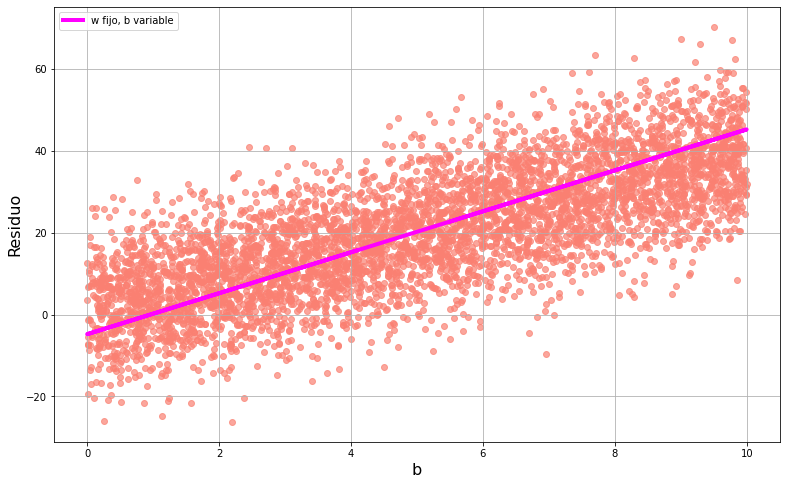

In [ ]:
plt.figure(figsize=(13,8))
plt.ylabel('Residuo', fontsize=16)
plt.xlabel('b', fontsize=16)
plt.grid(True)


plt.plot(x, weight_fijo*x+parameters_w_fijo[np.argmin(residuos_handMSE_w_fijo)][1], color='magenta', label='w fijo, b variable', lw=4)
plt.legend()
    
plt.scatter(x, y, color='salmon', alpha=0.7);

<font size = 4>

Se grafica la recta empleando los valores óptimos $ \hat w$ y $\hat b$.

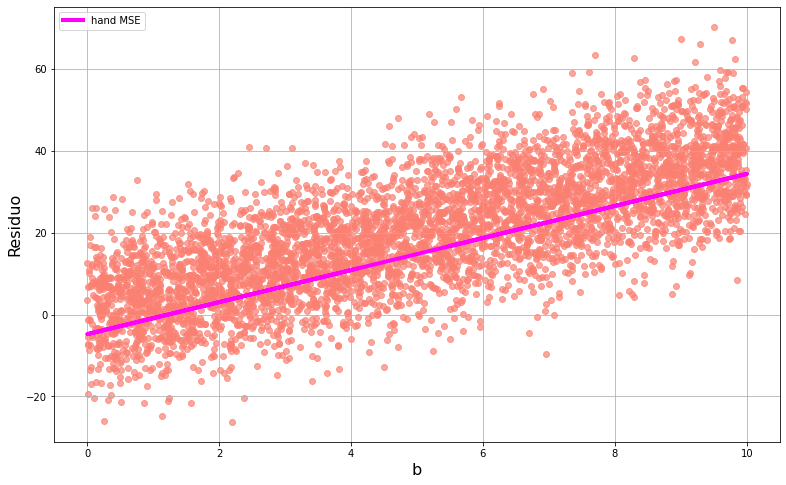

In [ ]:
plt.figure(figsize=(13,8))
plt.ylabel('Residuo', fontsize=16)
plt.xlabel('b', fontsize=16)
plt.grid(True)


plt.plot(x, parameters_b_fijo[np.argmin(residuos_handMSE_b_fijo)][0]*x+parameters_w_fijo[np.argmin(residuos_handMSE_w_fijo)][1], color='magenta', label='hand MSE', lw=4)
plt.legend()
    
plt.scatter(x, y, color='salmon', alpha=0.7);

___

<font color = 'blue' size = 4>

> # c) Método simple de mínimos cuadrados

<font size=4>

El método de mínimos cuadrados nos permite encontrar una función que describe la correlación que tienen un conjunto m de puntos (X, Y).


El objetivo del algoritmo es obtener la relación entre un conjunto de variables independientes X y la variable dependiente Y.

En el presente caso, se propone una función lineal para describir la correlación:

$$ F(x_i) = b + w x_i $$
 

Las variables b  y w definen a la función F. 

Con el método simple de mínimos cuadrados se hallan los valores óptimos $\hat{b}$ y $\hat{\omega}$ de estas variables.

<font size = 4>

La diferencia entre el valor real $y_i$ y el valor estimado $F(x_i)$ se denomina $r_i$:

$$ r_i = y_i - F(x_i) $$

El objetivo del método de mínimos cuadrados es minimizar la suma del cuadrado de los residuos, es decir, minimizar a:

$$ Residuo = \dfrac {1}{m} ∑_{i=1}^{m}r_{i}^{2} $$

Derivando parcialmente con respecto a los parámetros e igualando a cero se obtiene que:

$$ \dfrac{∂Residuo}{∂\hat{w}} =0⟶\hat{\omega}=\dfrac{∑_{i=1}^{n}(x_i–\bar x)(y_i–\bar y)}{∑_{i=1}^{m}(x_i–\bar x)^2}$$


$$ \dfrac{∂Residuo}{∂\hat{b}}=0⟶\hat{b}=y–\hat w x $$

en donde $\bar x$ y $\bar y$ son los promedios de las muestras.

La siguiente función realiza las operaciones anteriores:

In [ ]:
def mean_square_error(x, y):
    
    # 1) Se obtiene el promedio de los valores x_i y y_i

    mean_x = np.mean(x)
    mean_y = np.mean(y)

    # 2) se calcula (x_i-x) y (y_i-y), con x e y los promedios de x_i e y_i, respectivamente.

    x_i = []
    for i in x:
        x_i.append(np.squeeze(i) - mean_x)

    y_i = []
    for i in y:
        y_i.append(np.squeeze(i) - mean_y)

    # 3) se calcula (x_i-x)*(x_i-x)

    x_i2 = np.power(x_i, 2)

    # 4) se hacen las sumas correspondientes

    xy_sum = 0

    for i in range(len(x_i)):
        xy_sum += x_i[i]*y_i[i]
    x2_sum = 0

    for i in range(len(x_i)):
        x2_sum += x_i2[i]

    # Se definen a w y b 

    w = xy_sum/x2_sum
    b = mean_y - w*mean_x
       
    return w, b

<font size=4>
    
Se observan las $\hat{b}$ y $\hat{\omega}$ óptimas:

In [ ]:
w_MSE, b_MSE = mean_square_error(x, y)
print(" w = {0:5.2f}, b = {1:5.2f}".format(w_MSE,b_MSE))

 w =  3.92, b =  0.22


<font size=4>
    
Se grafica la función f con las $\hat{b}$ y $\hat{\omega}$ óptimas:

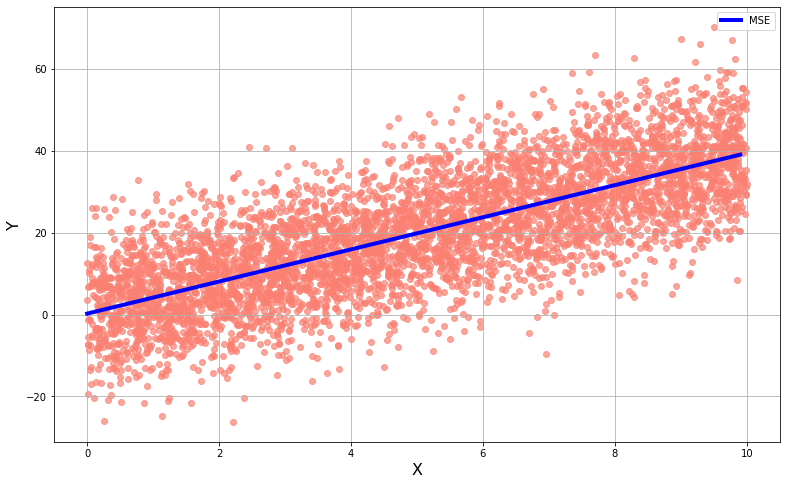

In [ ]:
x_ = np.arange(0.0, 10.0, 0.1)
y_MSE = x_*w_MSE + b_MSE

plt.figure(figsize=(13,8))
plt.ylabel('Y', fontsize=16)
plt.xlabel('X', fontsize=16)
plt.grid(True)

plt.plot(x_, y_MSE, color='blue', lw=4, label='MSE')
plt.legend()

plt.scatter(x, y, color='salmon', alpha=0.7);

<font size=4>
    
El 'error' encontrado es:

In [ ]:
MSE= 0

for i in range(len(x)):
    r = (y[i]-w_MSE*x[i] + b_MSE)**2
    MSE += np.squeeze(r)
MSE = MSE / len(x)

print('MSE: {0:10.2f}'.format(MSE))

MSE:      99.85


<font size=4>
    
Comparamos las funciones obtenidas con el método b)(hallar el residuo mínimo a mano) y el método c) (mínimos cuadrados):

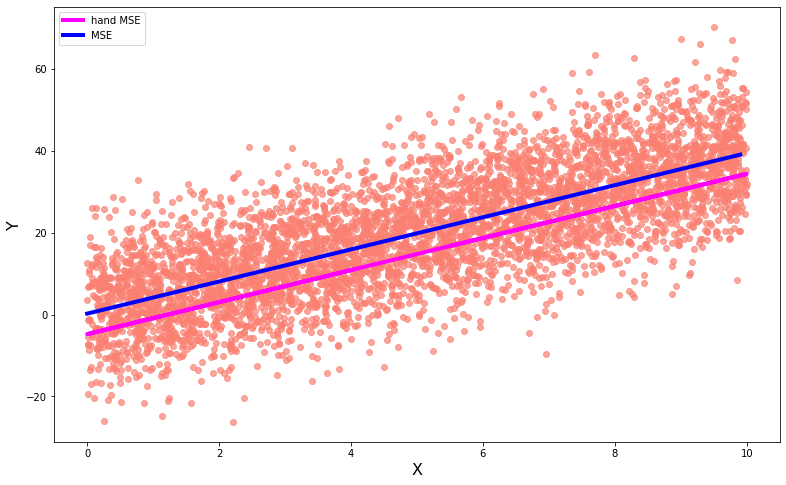

In [ ]:
plt.figure(figsize=(13,8))
plt.ylabel('Y', fontsize=16)
plt.xlabel('X', fontsize=16)


plt.plot(x, parameters_b_fijo[np.argmin(residuos_handMSE_b_fijo)][0]*x+parameters_w_fijo[np.argmin(residuos_handMSE_w_fijo)][1], color='magenta', label='hand MSE', lw=4)
plt.plot(x_, y_MSE, color='blue', lw=4, label='MSE')
plt.legend()

plt.scatter(x, y, color='salmon', alpha=0.7);

___

<font size=5, color='blue'>
    
> # d) Hallar los w y b óptimos usando gradiente descendente
  
 1. Se varian los valores de los parámetros $w$ y $b$ buscando reducir el residuo.


Se emplea el método de gradiente descendente para realizar esta variación.

Los parámetros $w$ y $b$ se deben actualizar, de manera que el MSE disminuya. 

Los parámetros se actualizan usando la siguientes ecuaciones:

$$ w := w - \alpha \dfrac{\partial MSE(w, b)}{\partial w}$$

$$ b := b - \alpha \dfrac{\partial MSE(w, b)}{\partial b}$$

$\alpha$: tasa de aprendizaje, es un hiperparámetro del modelo, y controla la velocidad con que el modelo aprenderá a ajustar a los parametros $w$ y $b$.


En este caso

$$ MSE = \dfrac{1}{m}∑_{i=1}^{m}(y_i-f(x_i))^{2} = \dfrac{1}{m}∑_{i=1}^{m}(y_i - w x_i - b)^2 $$

Entonces

$$ \dfrac{\partial MSE(w, b)}{\partial w} = \dfrac{2}{m}∑_{i=1}^{m}[(w x_i + b -y_i)(x_i)]$$

$$ \dfrac{\partial MSE(w, b)}{\partial b} = \dfrac{2}{m}∑_{i=1}^{m}[(w x_i + b -y_i)]$$



In [ ]:
#Función para actualizar el peso y el bias

def update_parameters(x, y, weight, bias, alfa, iteraciones):
    
    '''
    Esta función actualiza los parámetros (w,b) usando gradient descent
    
    INPUT
        x,y: muestras
        weight: peso inicial
        bias: bias inicial
        alfa: learning rate
        iteraciones: int que define el numero de veces a actualizar a los parámetros
    OUTPUT
        weights: lista con los pesos actualizados en cada iteración
        biases: lista con los bias actualizados en cada iteración
        residuos: lista con los residuos actualizados en cada iteración'''
    
    #1. inicializacion de parametros
    
    x = np.squeeze(x)
    y = np.squeeze(y)
    alfa = alfa
    residuo = 0
    d_w = 0.0
    d_b = 0.0
    m = len(x)  # especifica el número de muestras

    #2. Especificaciones de las graficas
    
    plt.figure(figsize=(20,8))    

    ax1 = plt.subplot(1,3,1)
    ax2 = plt.subplot(1,3,2)
    ax3 = plt.subplot(1,3,3)

    ax1.grid(True)
    ax2.grid(True)
    ax3.grid(True)
    
    ax1.scatter(x, y, color='salmon', alpha=0.7) # grafica las muestras
    ax1.set_title('Distancia vs tiempo', size=24)
    ax1.set_xlabel('Tiempo', size=18)
    ax1.set_ylabel('Distancia', size=18)

        # Recta generada con los parametros iniciales

    y_ = weight*x + bias     # es F(x, w, b)
    
    ax1.plot(x, y_, color='green', lw=4)
    
    #3. Se calcula el residuo
    
    weights = []      # se inicializan las listas weights, biases, residuos
    biases = []
    residuos = []
    
    for i in range(iteraciones):  

        # calculo de derivadas y el residuo

        for i in range(m):

            d_w += 2*(weight*x[i]+bias- y[i])*x[i]      
            d_b += 2*(weight*x[i]+bias-y[i])
            residuo += (y[i]-weight*x[i]-bias)**2

        residuo /= m
        d_w /= m
        d_b /= m
        
        weights.append(weight)      # se agregan los resultados calculados
        biases.append(bias)
        residuos.append(residuo)
        
        #4. Actualización de los parametros

        weight = weight - alfa*d_w
        bias = bias - alfa*d_b

        # Recta generada con la actualizacion de los parametros
        
        y_ = weight*x + bias    # es F(x,w_actualizado, b_actualizado)
        ax1.plot(x, y_, lw=4)

        #5. Grafica de los residuos como función de uno de los parámetros (el peso)
        
        ax2.scatter(weight, residuo)
        ax2.set_title('MSE vs weight', size=24)
        ax2.set_xlabel('weight', size=18)
        ax2.set_ylabel('MSE', size=18)

        #6. Grafica de los residuos como función de uno de los parámetros (el bias)
        
        ax3.scatter(bias, residuo)
        ax3.set_title('MSE vs bias', size=24)
        ax3.set_xlabel('bias', size=18)
        ax3.set_ylabel('MSE', size=18)

    return weights, biases, residuos

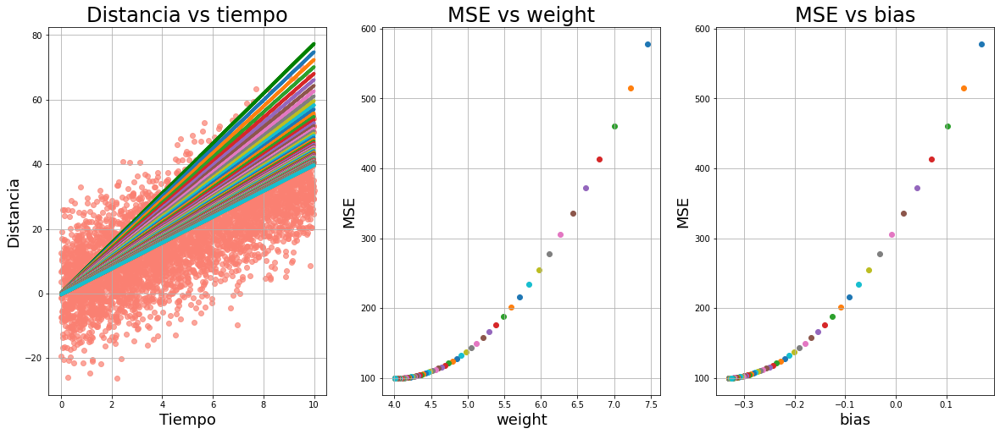

In [ ]:
weight = weight_0 
bias = bias_0 
alfa = 0.001
num_iter = 100

weights, biases, residuos_GD = update_parameters(x, y, weight, bias, alfa, num_iter)

<font size=4, color='blue'>
Se grafica el residuo como función de cada iteración en que se modificaron el bias y el peso.

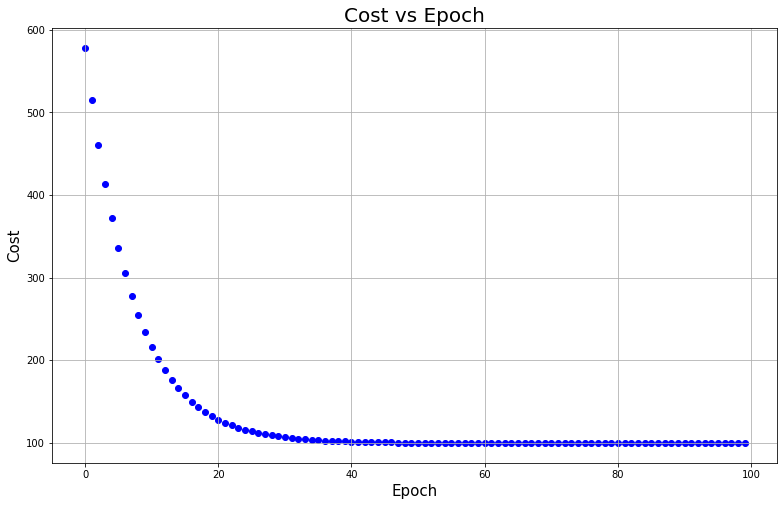

In [ ]:
plt.figure(figsize=(13, 8))
plt.grid(True)
plt.scatter(range(num_iter), residuos_GD, color='blue')
plt.title('Cost vs Epoch', size=20)
plt.xlabel('Epoch', size=15)
plt.ylabel('Cost', size=15);

Se grafica la recta con los parámetros óptimos:

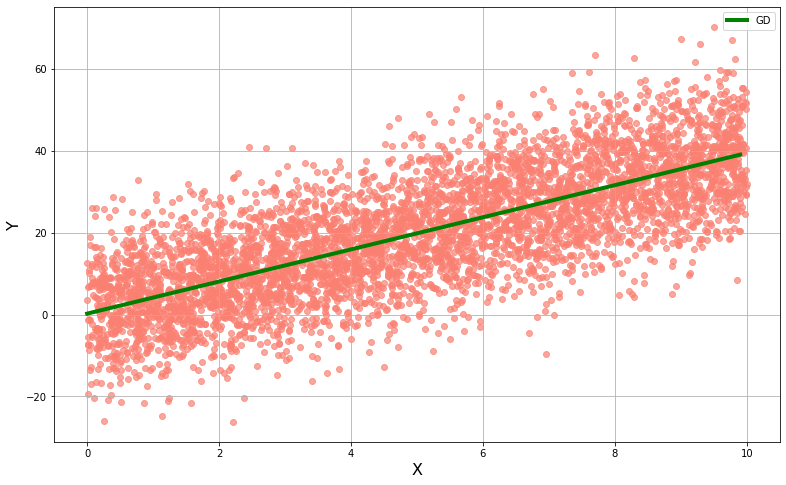

In [ ]:
x_ = np.arange(0.0, 10.0, 0.1)
y_GD = x_*weights[-1] + biases[-1]

plt.figure(figsize=(13,8))
plt.ylabel('Y', fontsize=16)
plt.xlabel('X', fontsize=16)
plt.grid(True)

plt.plot(x_, y_MSE, color='green', lw=4, label='GD')

plt.scatter(x, y, color='salmon', alpha=0.7)
plt.legend();

___

Graficamos los tres resultados (de b, c y d) y comparamos:

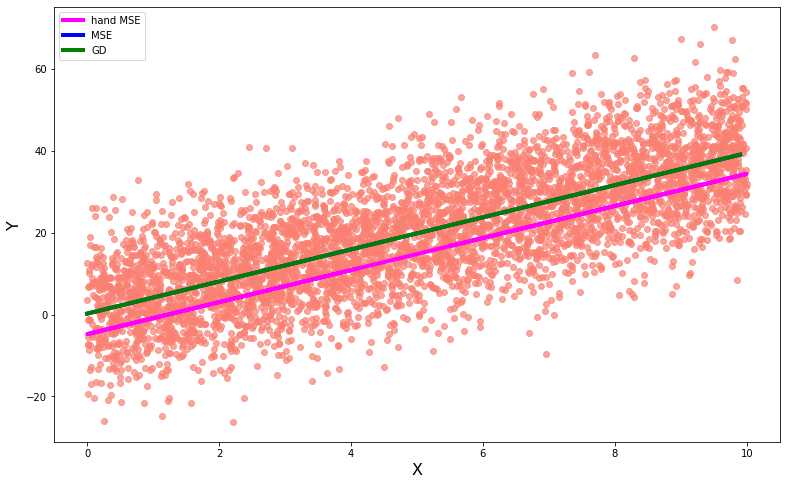

In [ ]:
plt.figure(figsize=(13,8))
plt.ylabel('Y', fontsize=16)
plt.xlabel('X', fontsize=16)


plt.plot(x, parameters_b_fijo[np.argmin(residuos_handMSE_b_fijo)][0]*x+parameters_w_fijo[np.argmin(residuos_handMSE_w_fijo)][1], color='magenta', label='hand MSE', lw=4)
plt.plot(x_, y_MSE, color='blue', lw=4, label='MSE')
plt.plot(x_, y_MSE, color='green', lw=4, label='GD')
plt.legend()

plt.scatter(x, y, color='salmon', alpha=0.7);